In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

In [2]:
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
import statsmodels.formula.api as smf
from sklearn.datasets import load_iris
from sklearn import linear_model 
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.pipeline import make_pipeline
from sklearn.datasets import make_regression
from sklearn.model_selection import train_test_split
from sklearn import metrics
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV
from sklearn import preprocessing 

# Load Data

In [3]:
housing= pd.read_csv("Data/housing.csv")
anscombe_df = pd.read_csv("Data/anscombe.csv")
print(housing.head())
print("------")
print(anscombe_df.head())

   longitude  latitude  housing_median_age  total_rooms  total_bedrooms  \
0    -122.23     37.88                  41          880           129.0   
1    -122.22     37.86                  21         7099          1106.0   
2    -122.24     37.85                  52         1467           190.0   
3    -122.25     37.85                  52         1274           235.0   
4    -122.25     37.85                  52         1627           280.0   

   population  households  median_income  median_house_value ocean_proximity  
0         322         126         8.3252              452600        NEAR BAY  
1        2401        1138         8.3014              358500        NEAR BAY  
2         496         177         7.2574              352100        NEAR BAY  
3         558         219         5.6431              341300        NEAR BAY  
4         565         259         3.8462              342200        NEAR BAY  
------
  dataset     x     y
0       I  10.0  8.04
1       I   8.0  6.95
2 

In [4]:
housing_df = housing.copy()
housing_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20635 entries, 0 to 20634
Data columns (total 10 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   longitude           20635 non-null  float64
 1   latitude            20635 non-null  float64
 2   housing_median_age  20635 non-null  int64  
 3   total_rooms         20635 non-null  int64  
 4   total_bedrooms      20428 non-null  float64
 5   population          20635 non-null  int64  
 6   households          20635 non-null  int64  
 7   median_income       20635 non-null  float64
 8   median_house_value  20635 non-null  int64  
 9   ocean_proximity     20635 non-null  object 
dtypes: float64(4), int64(5), object(1)
memory usage: 1.6+ MB


In [5]:
housing_df.describe()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
count,20635.000000,20635.000000,20635.000000,20635.000000,20428.000000,20635.000000,20635.000000,20635.000000,20635.000000
mean,-119.569999,35.632412,28.636152,2636.020208,537.899305,1425.660286,499.593700,3.870944,206813.756288
std,2.003685,2.135918,12.583924,2181.794772,421.425970,1132.530137,382.357072,1.899961,115372.499511
min,-124.350000,32.540000,1.000000,2.000000,1.000000,3.000000,1.000000,0.499900,14999.000000
25%,-121.800000,33.930000,18.000000,1448.000000,296.000000,787.000000,280.000000,2.563100,119600.000000
50%,-118.500000,34.260000,29.000000,2127.000000,435.000000,1166.000000,409.000000,3.535200,179700.000000
75%,-118.010000,37.710000,37.000000,3148.000000,647.000000,1725.000000,605.000000,4.743700,264700.000000
max,-114.310000,41.950000,52.000000,39320.000000,6445.000000,35682.000000,6082.000000,15.000100,500001.000000


# Analysis

* The figure below shows the results of our data analysis of some attributes.
* The figure below shows the relationship between the building age and the house price.

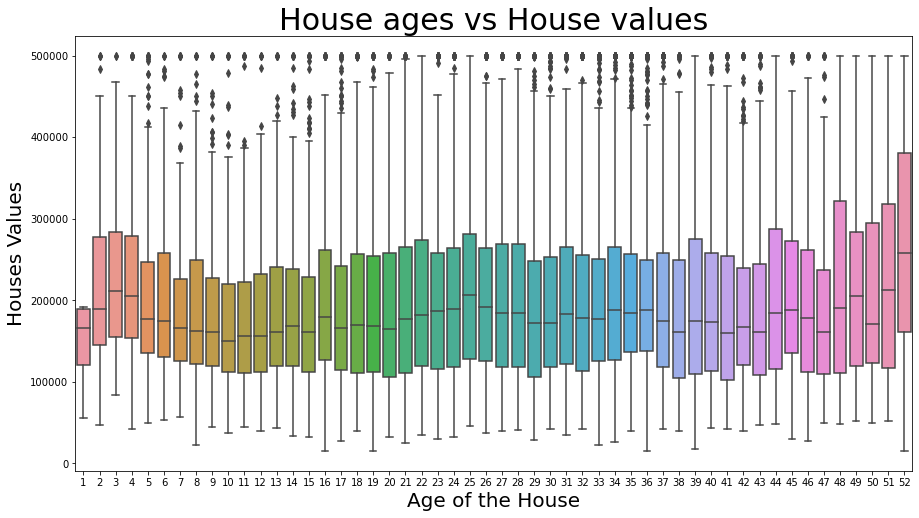

In [6]:
plt.figure(figsize=(15,8))
plt.title("House ages vs House values", fontsize="30")
sns.boxplot(housing_df["housing_median_age"], housing_df["median_house_value"])
plt.xlabel("Age of the House", fontsize = 20)
plt.ylabel("Houses Values", fontsize = 20)
plt.savefig("static/images/Boxplots_house_values_vs_house_age.png", bbox_inches ="tight")
plt.show()


* The figure below shows the distribution of housing prices with a bar chart.

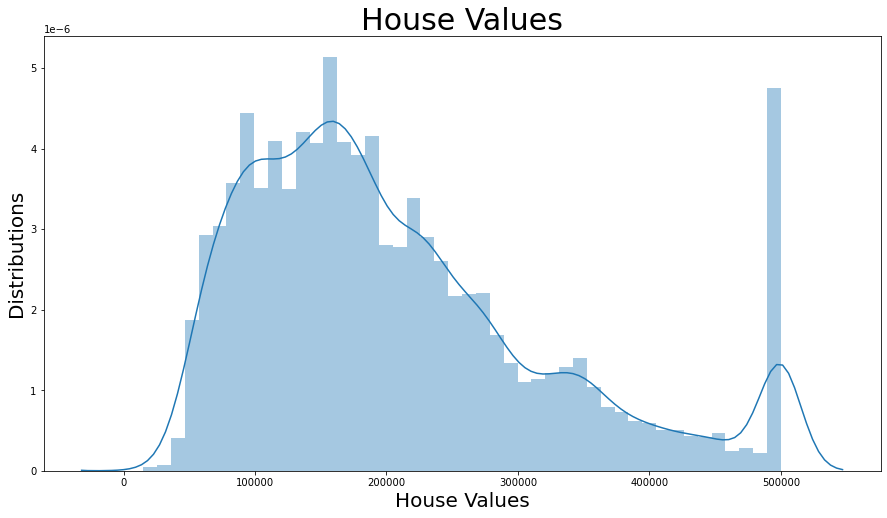

In [7]:
plt.figure(figsize=(15,8))
plt.title("House Values", fontsize="30")
sns.distplot(housing_df["median_house_value"])
plt.xlabel("House Values", fontsize = 20)
plt.ylabel("Distributions", fontsize = 20)
plt.savefig("static/images/barchart_house_values_distributions.png", bbox_inches ="tight")
plt.show()


* It can be seen from the figure that housing prices are concentrated in the range of 100000 and 200000, and the other 500000 are also relatively large. 

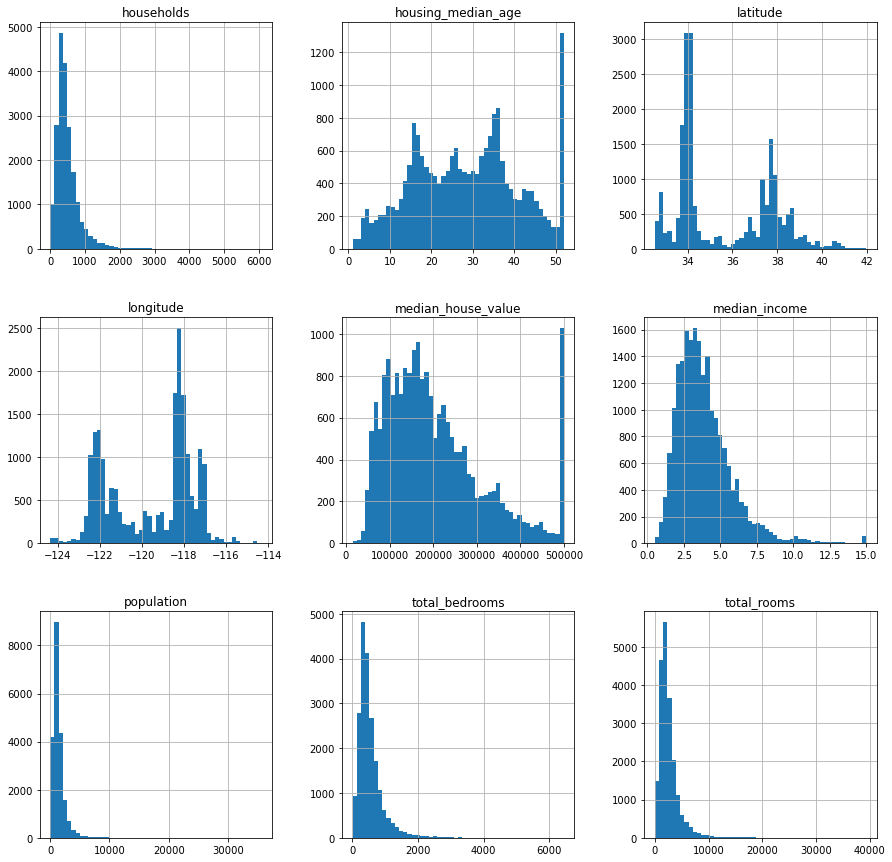

In [8]:
housing_df.hist(bins=50, figsize=(15,15))
plt.savefig("static/images/hist_all_data.png", bbox_inches ="tight")
plt.show()

* The attributes have different scales. It is recommended to rescale all the attributes.
* <b><u>The medium house value</u></b> has a sudden peak around 500000, which is very different from others.
* It is recommended to remove these data in training the model.
* <b><u>The medium income</u></b> is centered around 3, where the unit is unknown. Probably, 3 means $300,000.

In [9]:
housing_df["ocean_proximity"].value_counts()

<1H OCEAN     9136
INLAND        6551
NEAR OCEAN    2658
NEAR BAY      2290
Name: ocean_proximity, dtype: int64

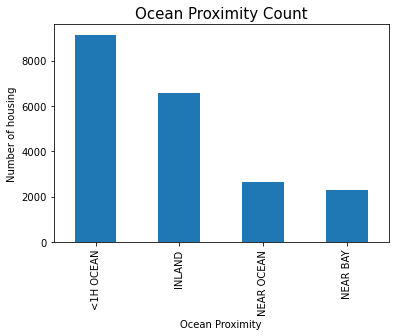

In [10]:

plt.title("Ocean Proximity Count", fontsize="15")
housing_df["ocean_proximity"].value_counts().plot(kind="bar")
plt.xlabel("Ocean Proximity", fontsize = 10)
plt.ylabel("Number of housing", fontsize = 10)
plt.savefig("static/images/Ocean_proximity_count.png", bbox_inches ="tight")
plt.show()


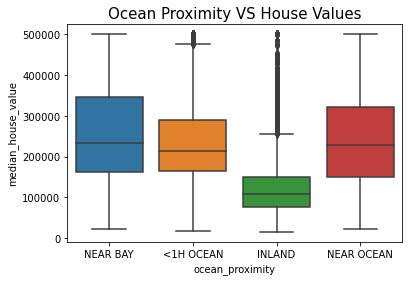

In [11]:
# Box plot for median house value vs ocean proximity
plt.title("Ocean Proximity VS House Values", fontsize="15")
sns.boxplot(x="ocean_proximity", y="median_house_value", data=housing_df)

plt.savefig("static/images/Ocean_proximity_vs_house_value.png", bbox_inches ="tight")
plt.show()

* Population and housing median ages

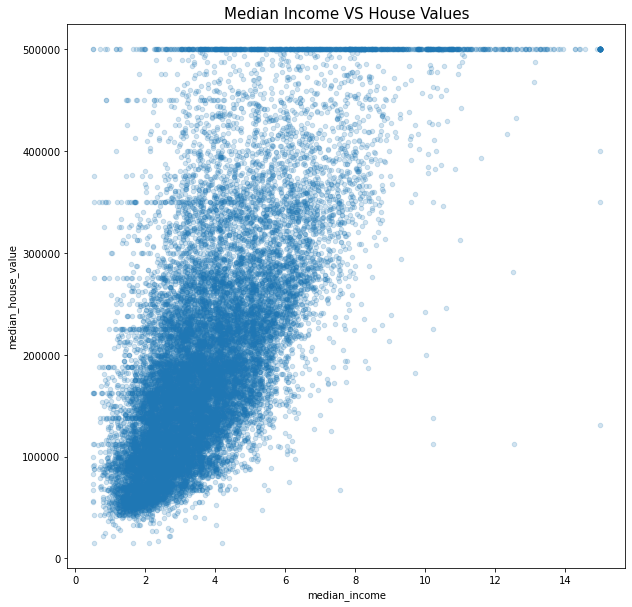

In [12]:
housing.plot(kind='scatter', x='median_income', y='median_house_value', alpha=0.2, figsize=(10,10))
plt.title("Median Income VS House Values", fontsize="15")

plt.savefig("static/images/housing_value_income.png", bbox_inches ="tight")
plt.show()

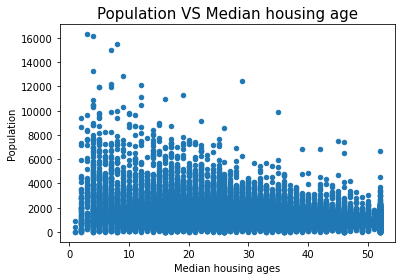

In [13]:
housing_df1 = housing_df.loc[housing_df["population"]<20000]


housing_df1.plot.scatter(x = "housing_median_age", y = "population")
plt.title("Population VS Median housing age", fontsize="15")
plt.xlabel("Median housing ages", fontsize = 10)
plt.ylabel("Population", fontsize = 10)
plt.savefig("static/images/scatter_population_vs_house_age.png", bbox_inches ="tight")
plt.show()

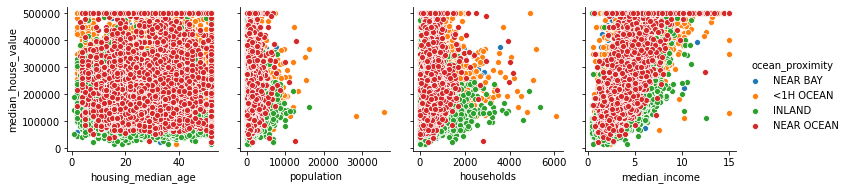

In [14]:
sns.pairplot(housing_df, x_vars=['housing_median_age', 'population', 'households', 'median_income'],y_vars ='median_house_value',hue = 'ocean_proximity')

In [15]:
map_dict = {'<1H OCEAN':0, 'INLAND':1, 'ISLAND':2, 'NEAR BAY':3, 'NEAR OCEAN':4}
def map_fea(x):
    return map_dict[x]
    
housing_df["ocean_proximity"] = housing_df["ocean_proximity"].apply(map_fea)
housing_df.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
0,-122.23,37.88,41,880,129.0,322,126,8.3252,452600,3
1,-122.22,37.86,21,7099,1106.0,2401,1138,8.3014,358500,3
2,-122.24,37.85,52,1467,190.0,496,177,7.2574,352100,3
3,-122.25,37.85,52,1274,235.0,558,219,5.6431,341300,3
4,-122.25,37.85,52,1627,280.0,565,259,3.8462,342200,3


#### Add a new categorical feature in order to split the dataset properly
* income_data

In [16]:
housing_df['income_data'] = np.ceil(housing_df['median_income']/1.5)
housing_df['income_data'].where(housing_df['income_data']<5, 5, inplace=True)

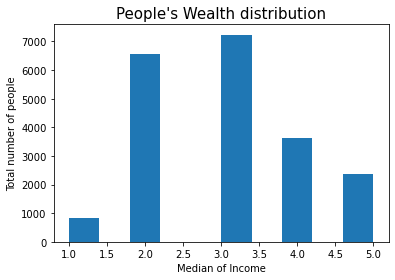

In [17]:
plt.title("People's Wealth distribution", fontsize="15")
plt.hist(housing_df.income_data)
plt.xlabel("Median of Income", fontsize = 10)
plt.ylabel("Total number of people", fontsize = 10)
plt.savefig("static/images/Wealth_total.png", bbox_inches ="tight")
plt.show()

In [18]:
housing_df.income_data.value_counts()/len(housing_df.income_data)

3.0    0.350618
2.0    0.318730
4.0    0.176351
5.0    0.114466
1.0    0.039835
Name: income_data, dtype: float64

* Most people has annual income more than $300,000

Prepare Data for Machine Learning Algorithm
* split the data into train and test sets based on the new feature

* Method 1: using the package train_test_split without the new feature
* Method 2: using the package StratifiedShuffleSplit with the new feature

In [19]:
from sklearn.model_selection import StratifiedShuffleSplit
from sklearn.model_selection import train_test_split

In [20]:
data4train,data4test = train_test_split(housing_df, test_size=0.2, random_state=42)

In [21]:
split = StratifiedShuffleSplit(n_splits=1, test_size=0.2, random_state = 42)

In [22]:
for train_index, test_index in split.split(housing_df, housing_df['income_data']):
    train_set = housing_df.loc[train_index]
    test_set  = housing_df.loc[test_index] 

In [23]:
def table4income_cat(dataset,df,label):
    df[label]=pd.Series(dataset['income_data'].value_counts()/len(dataset['income_data']))
    return df

In [24]:
df = pd.DataFrame()
df = table4income_cat(train_set,df,'All_set')
df = table4income_cat(train_set,df,'train_set_Shuff')
df = table4income_cat(test_set,df,'test_set_Shuff')
df = table4income_cat(data4train,df,'train_set_split')
df = table4income_cat(data4test,df,'test_set_split')
df

,All_set,train_set_Shuff,test_set_Shuff,train_set_split,test_set_split
3.0,0.350618,0.350618,0.350618,0.348437,0.359341
2.0,0.318755,0.318755,0.318633,0.318088,0.321299
4.0,0.176339,0.176339,0.176399,0.178944,0.165980
5.0,0.114429,0.114429,0.114611,0.115217,0.111461
1.0,0.039859,0.039859,0.039738,0.039314,0.041919


* It is shown above that the StratifiedShuffleSplit method works a little bit better as the income category propotions in train data and test data are closer to that in the all dataset.

* After split the data into train and test, we delete the newly added feature

In [25]:
# delete the new feature
for set_ in (housing_df, data4train, data4test, train_set, test_set):
    set_.drop("income_data",axis=1,inplace=True)

/anaconda3/envs/PythonData/lib/python3.6/site-packages/pandas/core/frame.py:3997: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


In [26]:
data4train.columns

Index(['longitude', 'latitude', 'housing_median_age', 'total_rooms',
       'total_bedrooms', 'population', 'households', 'median_income',
       'median_house_value', 'ocean_proximity'],
      dtype='object')

In [27]:
housing4train = train_set.copy()

In [28]:
housing4train.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
2750,-115.59,32.69,30,935,177.0,649,148,2.5769,94400,1
11982,-117.48,34.00,12,6751,1153.0,3266,1134,3.8529,145500,1
4394,-118.28,34.08,42,997,374.0,982,372,2.9423,200000,0
3838,-118.44,34.19,29,1599,459.0,1143,438,2.4583,199100,0
12493,-121.46,38.56,52,1750,372.0,764,369,2.9191,111800,1


## <u>California Mapping</u>
* Population distribution among the California

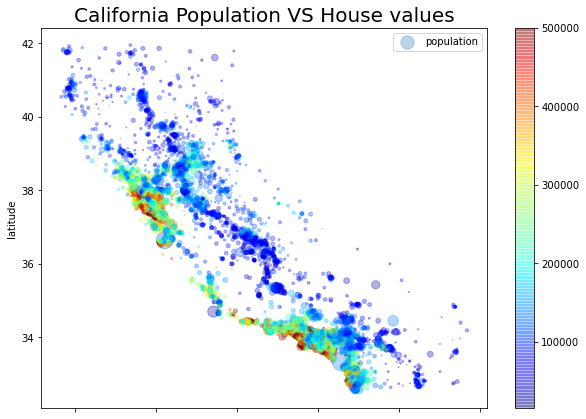

In [29]:
housing4train.plot(kind='scatter', x='longitude', y='latitude', alpha=0.3,
         s=housing4train['population']/100, label='population',   # set symbol size on population
         c=housing4train['median_house_value'],                  #  set symbol color on house value    
         cmap=plt.get_cmap('jet'),      
         colorbar=True,
         figsize=(10,7))
plt.legend()
plt.title("California Population VS House values", fontsize = 20)
plt.savefig("static/images/Maps_California_population_values.png", bbox_inches ="tight")
plt.show()

## <u>Correlation</u>
* The following figure shows the analysis of the correlation between attributes.

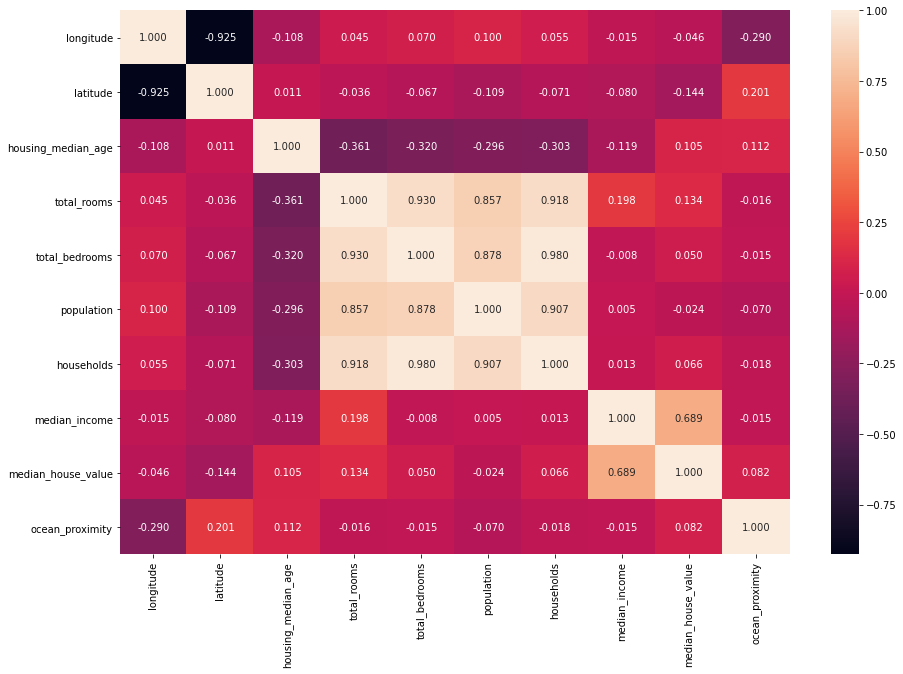

In [30]:
plt.figure(figsize=(15,10))
sns.heatmap(housing_df.corr(),annot=True,fmt=".3f")

plt.savefig("static/images/Correlation_heatmap.png")

* It can be seen from the figure that the income attribute has a strong correlation with the housing price.

In [31]:
# calculated attributes
housing['rooms_per_household'] = housing['total_rooms']/housing['households']
housing['bedrooms_per_room'] = housing['total_bedrooms']/housing['total_rooms']
housing['population_per_household'] = housing['population']/housing['households']

# checkout the correlations again
corr_matrix = housing.corr()
corr_matrix['median_house_value'].sort_values(ascending=False)

median_house_value          1.000000
median_income               0.688563
rooms_per_household         0.151968
total_rooms                 0.134373
housing_median_age          0.105272
households                  0.066069
total_bedrooms              0.049792
population_per_household   -0.023719
population                 -0.024421
longitude                  -0.046208
latitude                   -0.143837
bedrooms_per_room          -0.256397
Name: median_house_value, dtype: float64

## Test Model 1

In [32]:
housing_df2 = housing.copy()

In [33]:
housing_df2["house_pop"] = housing_df2["households"]/housing_df2["population"]

In [34]:
housing_df2 = pd.get_dummies(housing_df2, columns=["ocean_proximity"])

In [35]:
housing_df2.columns
housing_df2_norm = housing_df2.copy()

In [36]:
scaler = MinMaxScaler()
column_names_to_normalize = ['longitude', 'latitude', 'housing_median_age', 'total_rooms',
       'total_bedrooms', 'population', 'households', 'median_income',
       'median_house_value', 'house_pop']
x = housing_df2_norm[column_names_to_normalize].values
x_scaled = scaler.fit_transform(x)
df_temp = pd.DataFrame(x_scaled, columns=column_names_to_normalize, index = housing_df2_norm.index)
housing_df2_norm[column_names_to_normalize] = df_temp

In [37]:
housing_df2_norm.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,rooms_per_household,bedrooms_per_room,population_per_household,house_pop,ocean_proximity_<1H OCEAN,ocean_proximity_INLAND,ocean_proximity_NEAR BAY,ocean_proximity_NEAR OCEAN
0,0.211155,0.567481,0.784314,0.022331,0.019863,0.008941,0.020556,0.539668,0.902266,6.984127,0.146591,2.555556,0.270497,0,0,1,0
1,0.212151,0.565356,0.392157,0.180503,0.171477,0.067210,0.186976,0.538027,0.708247,6.238137,0.155797,2.109842,0.327758,0,0,1,0
2,0.210159,0.564293,1.000000,0.037260,0.029330,0.013818,0.028943,0.466028,0.695051,8.288136,0.129516,2.802260,0.246634,0,0,1,0
3,0.209163,0.564293,1.000000,0.032352,0.036313,0.015555,0.035849,0.354699,0.672783,5.817352,0.184458,2.547945,0.271306,0,0,1,0
4,0.209163,0.564293,1.000000,0.041330,0.043296,0.015752,0.042427,0.230776,0.674638,6.281853,0.172096,2.181467,0.316978,0,0,1,0


* In order to quantify our model against new input values, we split the data into training and testing data. The model is then fit to the training data and scored by the test data. Sklean pre-processing provides a library for automatically splitting up the data into training and testing

In [38]:
m1_data = housing_df2.copy()
m1Y = m1_data['median_house_value']
m2_data = housing_df2.copy()
m2_data.drop(columns=['total_rooms',
       'total_bedrooms','population','households'],inplace=True)
m1_data.drop(columns=['median_house_value','total_rooms',
       'total_bedrooms','population','households'],inplace=True)
m1_data.columns

Index(['longitude', 'latitude', 'housing_median_age', 'median_income',
       'rooms_per_household', 'bedrooms_per_room', 'population_per_household',
       'house_pop', 'ocean_proximity_<1H OCEAN', 'ocean_proximity_INLAND',
       'ocean_proximity_NEAR BAY', 'ocean_proximity_NEAR OCEAN'],
      dtype='object')

In [39]:
m1X_train, m1X_test, m1y_train, m1y_test = train_test_split(m1_data, m1Y, test_size=0.2,random_state=1)

In [40]:
model1 = linear_model.LinearRegression()
model1.fit(m1X_train, m1y_train)

ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

In [107]:
m1y_pred = model1.predict(m1X_test)

In [108]:
print("Metrics mean squared error: ", metrics.mean_squared_error(m1y_test, m1y_pred))
print("Square root: ", np.sqrt(metrics.mean_squared_error(m1y_test, m1y_pred)))

Metrics mean squared error:  4441821999.1420145
Square root:  66646.99542471525


In [109]:
print("Accuracy: ", round(model1.score(m1X_train, m1y_train) * 100,2), "%")

Accuracy:  67.03 %


In [110]:
m2_data.rename(columns={'ocean_proximity_<1H OCEAN': 'ocean_proximity1', 'ocean_proximity_NEAR BAY': 'ocean_proximity2', 'ocean_proximity_NEAR OCEAN': 'ocean_proximity3'}, inplace=True)


In [111]:
lm2 = smf.ols(formula='median_house_value ~ longitude + latitude + housing_median_age  + median_income + house_pop + ocean_proximity1 + ocean_proximity_INLAND + ocean_proximity2 + ocean_proximity3', data=m2_data).fit()

# Training Models:

### <u>Decision Tree</u>


In [112]:
model_dt = make_pipeline(preprocessing.StandardScaler(),DecisionTreeRegressor(random_state=0))
scores = cross_val_score(model_dt, m1X_train, m1y_train, cv=10)

model_dt.fit(m1X_train, m1y_train)
pred = model_dt.predict(m1X_test)

MSE = metrics.mean_squared_error(m1y_test, pred)
RMSE = np.sqrt(metrics.mean_squared_error(m1y_test, pred))

dic={}

dic['DecisionTree'] = (RMSE,scores.mean() *100)

print("Decision Tree")
print("---------------------")
print("MSE:", MSE, "RMSE:", RMSE)
print("Accuracy: %0.2f (+/- %0.2f)" % (scores.mean() *100, scores.std() * 2))

Decision Tree
---------------------
MSE: 4617141020.29828 RMSE: 67949.5476092246
Accuracy: 62.12 (+/- 0.05)


### <u>Linear Regression</u>

In [113]:
model_lr = make_pipeline(preprocessing.StandardScaler(),linear_model.LinearRegression())
scores = cross_val_score(model_lr, m1X_train, m1y_train, cv=10)

model_lr.fit(m1X_train, m1y_train)
pred = model_lr.predict(m1X_test)

MSE = metrics.mean_squared_error(m1y_test, pred)
RMSE = np.sqrt(metrics.mean_squared_error(m1y_test, pred))

dic['LinearRegression'] = (RMSE,scores.mean() *100)

print("Linear Regression")
print("---------------------")
print("MSE:", MSE, "RMSE:", RMSE)
print("Accuracy: %0.2f (+/- %0.2f)" % (scores.mean() *100, scores.std() * 2))

Linear Regression
---------------------
MSE: 4441821999.1420145 RMSE: 66646.99542471525
Accuracy: 66.87 (+/- 0.04)


In [114]:
print(model_lr)

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('linearregression', LinearRegression())])


### <u>Random Forest</u>


In [115]:
print("Random Forest")
print("---------------------")
model_rf = make_pipeline(preprocessing.StandardScaler(),RandomForestRegressor(max_depth=2, random_state=0))
scores = cross_val_score(model_rf, m1X_train, m1y_train, cv=10)
model_rf.fit(m1X_train, m1y_train)
pred = model_rf.predict(m1X_test)

MSE = metrics.mean_squared_error(m1y_test, pred)
RMSE = np.sqrt(metrics.mean_squared_error(m1y_test, pred))

dic['RFD_2'] = (RMSE,scores.mean() *100)
print("Depth:2 Accuracy: %0.2f (+/- %0.2f)" % (scores.mean() *100, scores.std() * 2))

# ------------------------------------------------------------------------------------------

model_rf = make_pipeline(preprocessing.StandardScaler(),RandomForestRegressor(max_depth=5, random_state=0))
scores = cross_val_score(model_rf, m1X_train, m1y_train, cv=10)


model_rf.fit(m1X_train, m1y_train)
pred = model_rf.predict(m1X_test)

MSE = metrics.mean_squared_error(m1y_test, pred)
RMSE = np.sqrt(metrics.mean_squared_error(m1y_test, pred))

dic['RFD_5'] = (RMSE,scores.mean() *100)

print("Depth:5 Accuracy: %0.2f (+/- %0.2f)" % (scores.mean() *100, scores.std() * 2))

# ------------------------------------------------------------------------------------------
model_rf = make_pipeline(preprocessing.StandardScaler(),RandomForestRegressor(max_depth=10, random_state=0))
scores = cross_val_score(model_rf, m1X_train, m1y_train, cv=10)


model_rf.fit(m1X_train, m1y_train)
pred = model_rf.predict(m1X_test)

MSE = metrics.mean_squared_error(m1y_test, pred)
RMSE = np.sqrt(metrics.mean_squared_error(m1y_test, pred))

dic['RFD_10'] = (RMSE,scores.mean() *100)

print("Depth:10 Accuracy: %0.2f (+/- %0.2f)" % (scores.mean() *100, scores.std() * 2))

# ------------------------------------------------------------------------------------------

model_rf = make_pipeline(preprocessing.StandardScaler(),RandomForestRegressor(max_depth=20, random_state=0))
scores = cross_val_score(model_rf, m1X_train, m1y_train, cv=10)

model_rf.fit(m1X_train, m1y_train)
pred = model_rf.predict(m1X_test)

MSE = metrics.mean_squared_error(m1y_test, pred)
RMSE = np.sqrt(metrics.mean_squared_error(m1y_test, pred))

dic['RFD_20'] = (RMSE,scores.mean() *100)

print("Depth:20 Accuracy: %0.2f (+/- %0.2f)" % (scores.mean() *100, scores.std() * 2))

# ------------------------------------------------------------------------------------------

model_rf = make_pipeline(preprocessing.StandardScaler(),RandomForestRegressor(max_depth=50, random_state=0))
scores = cross_val_score(model_rf, m1X_train, m1y_train, cv=10)

model_rf.fit(m1X_train, m1y_train)
pred = model_rf.predict(m1X_test)

MSE = metrics.mean_squared_error(m1y_test, pred)
RMSE = np.sqrt(metrics.mean_squared_error(m1y_test, pred))

dic['RFD_50'] = (RMSE,scores.mean() *100)

print("Depth:50 Accuracy: %0.2f (+/- %0.2f)" % (scores.mean() *100, scores.std() * 2))

Random Forest
---------------------
Depth:2 Accuracy: 50.70 (+/- 0.05)
Depth:5 Accuracy: 69.14 (+/- 0.03)
Depth:10 Accuracy: 78.78 (+/- 0.02)
Depth:20 Accuracy: 80.78 (+/- 0.02)
Depth:50 Accuracy: 80.77 (+/- 0.02)


In [117]:
test = model_rf.fit(m1X_train, m1y_train)


In [118]:
pred = test.predict(m1X_test)

In [119]:
print("Root Mean Square Error: ", np.sqrt(metrics.mean_squared_error(m1y_test, pred)))


Root Mean Square Error:  49086.121789659635


In [120]:
pd.DataFrame(zip(m1_data.columns,model1.coef_), columns = ['Category', 'Coefficient'])

,Category,Coefficient
0,longitude,-27112.922171
1,latitude,-26937.990991
2,housing_median_age,931.031457
3,median_income,37716.947614
4,house_pop,318870.166674
5,ocean_proximity_<1H OCEAN,12299.429557
6,ocean_proximity_INLAND,-26459.925894
7,ocean_proximity_NEAR BAY,4372.922741
8,ocean_proximity_NEAR OCEAN,9787.573596


In [121]:
pd.DataFrame(zip(m1y_test,m1y_pred),columns=['Actual','Predicted'])

,Actual,Predicted
0,378000,328757.092978
1,90600,39415.941228
2,86600,144665.451318
3,112500,183094.439625
4,183900,262843.550722
...,...,...
4122,190000,175634.957134
4123,165000,132728.389007
4124,166700,159670.615150
4125,175000,137373.784085


* As you can see, the sample predictions are not very good: such as the first one: it is off by (378000-326749)/378000~=13%.

## Output all results


In [122]:
accuracy_model = pd.DataFrame(dic,index=['RMSE','Training_Accuracy (%)'])
accuracy_model = accuracy_model.T
accuracy_model

,RMSE,Training_Accuracy (%)
DecisionTree,67949.547609,62.120714
LinearRegression,66646.995425,66.868735
RFD_2,82114.177256,50.702067
RFD_5,64458.246562,69.142615
RFD_10,52221.510880,78.779544
RFD_20,49180.204775,80.780807
RFD_50,49086.121790,80.771869


In [124]:
accuracy_model.sort_values(by=['Training_Accuracy (%)'],inplace=True)


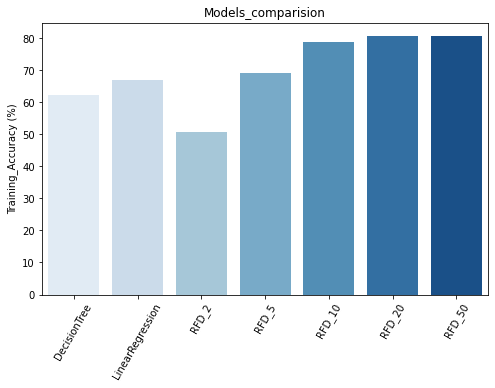

In [116]:
fig1, ax1 = plt.subplots(figsize=(8,5))
sns.barplot(x=accuracy_model.index,y='Training_Accuracy (%)',data=accuracy_model,ax=ax1,palette='Blues')
plt.title("Models_comparision")
plt.xticks(rotation = "60")
plt.savefig("static/images/model_comparision.png", bbox_inches ="tight")
plt.show()

#### ------------------------------------------------------------------------------------------
#### * It can be seen from the figure that the effect of random forest model is the best, far better than the other two models. The effect of using decision tree is the worst.
#### ------------------------------------------------------------------------------------------